# Simulations
How To simulate
in this notebook we want to give an example how the Ensembler package can be used to simulate systems.

In [1]:
#if package is not installed:
import os, sys
my_path = os.getcwd()+"/.."
sys.path.append(my_path)


import tempfile
import numpy as np
from matplotlib import pyplot as plt
from IPython.display import HTML

%matplotlib inline


#Ensembler
##COde
from ensembler.potentials.OneD import harmonicOscillatorPotential
from ensembler.samplers.stochastic import monteCarloIntegrator, metropolisMonteCarloIntegrator, langevinIntegrator, langevinVelocityIntegrator
from ensembler.samplers.newtonian import positionVerletIntegrator, velocityVerletIntegrator, leapFrogIntegrator
from ensembler.samplers.optimizers import conjugate_gradient
from ensembler.system import system

##Visualisation
from ensembler.visualisation.plotPotentials import plot_1DPotential
from ensembler.visualisation.plotSimulations import static_sim_plots
from ensembler.visualisation.animationSimulation import animation_trajectory, animation_EDS_trajectory


## General Settings

In [2]:
sim_steps=1000

### Define a Potential
Here we define a Potetial, that we want to integrate (you can find more potential Examples in the BasicPotential jupyter notebook).

(<Figure size 243.78x150.664 with 2 Axes>, None)

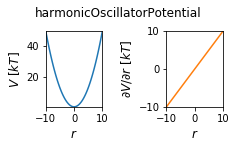

In [3]:
#settings
space_range = [-10, 10]

##Simulation Setup
pot=harmonicOscillatorPotential()

#Visualize
positions = np.linspace(-10,10, 100)
plot_1DPotential(pot, positions=positions)


## Stochastic Integrators

### MonteCarlo  Simulations



last_state:  State(position=array(6.40261798), temperature=298.0, total_system_energy=20.496758492564126, total_potential_energy=20.496758492564126, total_kinetic_energy=nan, dhdpos=array(0.02510512), velocity=nan)
1001


(<Figure size 602.656x150.664 with 3 Axes>, None)

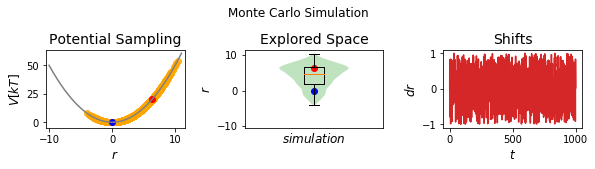

In [4]:
#Build System
sampler = monteCarloIntegrator()
sys=system(potential=pot, sampler=sampler,  start_position=0)

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))

sys.trajectory.head()

#visualize Simulation in Plot:
static_sim_plots(sys, title="Monte Carlo Simulation", limits_coordinate_space=list(range(-10,11)))

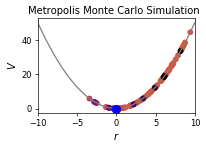

In [5]:
#Show Animation
animation, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Metropolis Monte Carlo Simulation", every_n_frame=10)
animation

### Metropolis Monte Carlo



last_state:  State(position=array(-4.18808818), temperature=298.0, total_system_energy=8.77004130913538, total_potential_energy=8.77004130913538, total_kinetic_energy=nan, dhdpos=array(0.65232716), velocity=nan)
1001


(<Figure size 602.656x150.664 with 3 Axes>, None)

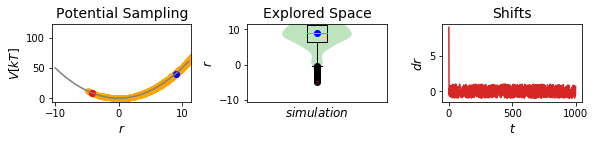

In [6]:
#super easy Metropolis_MonteCarlo simulation
sampler = metropolisMonteCarloIntegrator()
sys=system(potential=pot, sampler=sampler,  start_position=9)

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()

#plot
static_sim_plots(sys, limits_coordinate_space=space_range)

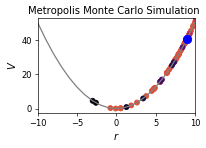

In [7]:
#plot
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Metropolis Monte Carlo Simulation", every_n_frame=10)
ani


## Optimizer - First order Methods

### Conjugated Gradient



last_state:  State(position=0.0, temperature=298.0, total_system_energy=0.0, total_potential_energy=0.0, total_kinetic_energy=nan, dhdpos=0.0, velocity=nan)
1001


(<Figure size 602.656x150.664 with 3 Axes>, None)

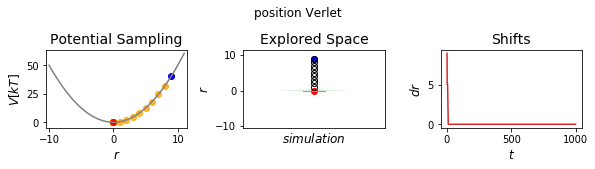

In [8]:
#settings
sampler = conjugate_gradient()
sys=system(potential=pot, sampler=sampler,  start_position=9)

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()

#plot
static_sim_plots(sys, title="position Verlet", limits_coordinate_space=space_range)

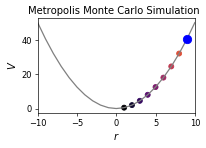

In [9]:
#animation
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Metropolis Monte Carlo Simulation")
ani

## Newtonian Integrators - Second order Methods

### Position Verlet

(<Figure size 602.656x150.664 with 3 Axes>, None)

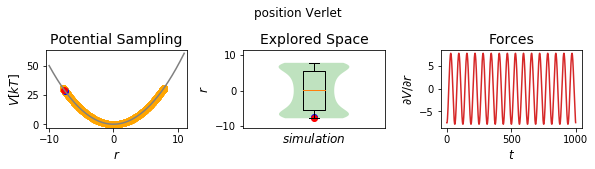

In [10]:
#Simulation Setup
sampler = positionVerletIntegrator(dt=0.1)
sys=system(potential=pot, sampler=sampler, start_position=-7.5)

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True, init_system=False)

sys.trajectory.head()

#plot
static_sim_plots(sys, title="position Verlet", limits_coordinate_space=space_range)

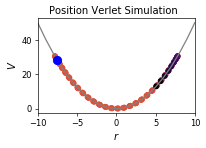

In [11]:
#animation
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Position Verlet Simulation")
ani

### Langevin Integrator


Trajectory length:  1001

last_state:  State(position=0.7343564101083007, temperature=15, total_system_energy=0.26963966853357535, total_potential_energy=0.26963966853357535, total_kinetic_energy=nan, dhdpos=-0.6704378398244542, velocity=None)
1001


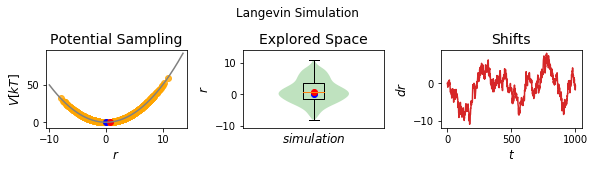

In [12]:
#Simple Langevin integration simulation:
#Thermostat is already included (Langevin thermostat)

#imports
from ensembler.conditions.box_conditions import periodicBoundaryCondition

time_step = 0.2
start_position = 0
temperature = 15
space_range = [-10,10]

#Simulation Setup
pbc = periodicBoundaryCondition(boundary=[space_range])
sampler = langevinIntegrator(dt=time_step, gamma=15, old_Position=0.01)
sys=system(potential=pot, sampler=sampler,  start_position=0,  temperature=temperature, conditions=[pbc])

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True, init_system=False)

print("Trajectory length: ",len(sys.trajectory))
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()

##visualize
fig, out_path = static_sim_plots(sys, title="Langevin Simulation")


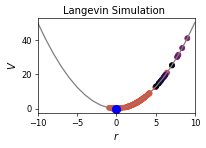

In [13]:
#animation
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Langevin Simulation")
ani

## TwoD potentials

### MonteCarlo

In [14]:
print(pbc)

Periodic Boundary Condition
	Dimensions: 1

	apply every step: 1
	Higher bounds: [10]
	Lower bounds: [-10]



In [15]:
from ensembler.potentials.TwoD import wavePotential
from ensembler.conditions.box_conditions import periodicBoundaryCondition

#super easy Metropolis_MonteCarlo simulation
#settings
space_range = [-180, 180]
sim_steps=500#0
pbc = periodicBoundaryCondition(boundary=[space_range, space_range])
pot2D=wavePotential(multiplicity=[2,2])
sampler = metropolisMonteCarloIntegrator(minStepSize=5)
sys=system(potential=pot2D, sampler=sampler,  conditions=[pbc], start_position=[0,100])

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()


TypeError: __init__() got an unexpected keyword argument 'minStepSize'

In [ ]:
test_timing_with_points=100
positions = np.linspace(-180, 180, test_timing_with_points)
x_positions, y_positions = np.meshgrid(positions,positions)
positions2D = np.array([x_positions.flatten(), y_positions.flatten()]).T

traj_pos = np.array(list(map(lambda x: np.array(x), sys.trajectory.position))).T

plt.imshow(pot.ene(positions2D).reshape([test_timing_with_points,test_timing_with_points]), extent=[*space_range, *space_range])
plt.scatter(*traj_pos, color="orange")

### Lagevin

In [ ]:
import os, sys
my_path = os.getcwd()+"/.."
print(my_path)
sys.path.append(my_path)

from IPython.display import HTML

import tempfile
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
%matplotlib inline


#Ensembler
##COde
from ensembler.potentials.OneD import harmonicOscillatorPotential
from ensembler.samplers.stochastic import monteCarloIntegrator, metropolisMonteCarloIntegrator, langevinIntegrator, langevinVelocityIntegrator
from ensembler.samplers.newtonian import positionVerletIntegrator, velocityVerletIntegrator, leapFrogIntegrator
from ensembler.samplers.optimizers import conjugate_gradient
from ensembler.system import system

##Visualisation
from ensembler.visualisation.plotSimulations import static_sim_plots
from ensembler.visualisation.animationSimulation import animation_trajectory, animation_EDS_trajectory



In [ ]:
from ensembler.potentials.TwoD import wavePotential

#super easy Metropolis_MonteCarlo simulation
#settings
space_range = [-180, 180]
sim_steps=10000
pbc = periodicBoundaryCondition.periodicBoundaryCondition(boundary=[space_range, space_range])
pot2D=wavePotential(multiplicity=[2,2])
sampler = langevinIntegrator(dt=1, gamma=10 , oldstart_position=[20.01,70.01])
sys=system(potential=pot2D, sampler=sampler,  start_position=[20,70], temperature=1, conditions=[pbc])

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True) #500000, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()


In [ ]:
test_timing_with_points=100
positions = np.linspace(-180, 180, test_timing_with_points)
x_positions, y_positions = np.meshgrid(positions,positions)
positions2D = np.array([x_positions.flatten(), y_positions.flatten()]).T

traj_pos = np.array(list(map(lambda x: np.array(x), sys.trajectory.position))).T

plt.imshow(pot.ene(positions2D).reshape([test_timing_with_points,test_timing_with_points]), extent=[*space_range,*space_range])
plt.scatter(*traj_pos, color="orange")

### Position Verlet

In [ ]:
from ensembler.potentials.TwoD import wavePotential

#super easy Metropolis_MonteCarlo simulation
#settings
space_range = [-180, 180]
pbc = periodicBoundaryCondition.periodicBoundaryCondition(boundary=[space_range, space_range])

sim_steps=1000
pot2D=wavePotential(multiplicity=[2,2])
sampler = positionVerletIntegrator(dt=0.1)
sys=system(potential=pot2D, sampler=sampler,  start_position=[9,9], temperature=1, conditions=[pbc])

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True) 
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()


In [ ]:
test_timing_with_points=100
positions = np.linspace(-180, 180, test_timing_with_points)
x_positions, y_positions = np.meshgrid(positions,positions)
positions2D = np.array([x_positions.flatten(), y_positions.flatten()]).T

traj_pos = np.array(list(map(lambda x: np.array(x), sys.trajectory.position))).T

plt.imshow(pot.ene(positions2D).reshape([test_timing_with_points,test_timing_with_points]), extent=[*space_range, *space_range])
plt.scatter(*traj_pos, color="orange")